In [1]:
import torch
import torch.nn as nn
from torchvision.models import vgg16
from torch.utils.data import Dataset, DataLoader
from glob import glob
import os
import matplotlib.pyplot as plt
from torchvision.transforms import Compose, CenterCrop, ToTensor
from PIL import Image
import cv2
import numpy as np
import pandas as pd
from torchvision.datasets import CocoDetection
from torch.utils.tensorboard import SummaryWriter
import time
from torchvision.datasets import CelebA
%load_ext tensorboard

/home/chinmay/anaconda3/envs/openslide_env/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/chinmay/anaconda3/envs/openslide_env/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/chinmay/anaconda3/envs/openslide_env/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/

In [2]:
"""
A wrapper for recording the time taken for execution of a method

Usage
@timeit
def method(arguments):
    pass
"""
def timeit(method):
    def timed(*args, **kw):
        ts = time.time()
        result = method(*args, **kw)
        te = time.time()
        if 'log_time' in kw:
            name = kw.get('log_name', method.__name__.upper())
            kw['log_time'][name] = int((te - ts) * 1000)
        else:
            print('{},  {} ms'.format(method.__name__, (te - ts) * 1000))
        return result
    return timed

In [3]:
# path to project folder.
root = '' 
# root = 'drive/My Drive/CSE 676/Project 2'

# **DATASETS**

In [4]:
def loader(dataset, batch_size, num_workers=1, shuffle=True):
    data_loader = torch.utils.data.DataLoader(dataset,
                                              batch_size,
                                              num_workers=num_workers,
                                              shuffle=shuffle)
    return data_loader

class CocoDataset(Dataset):
    """
    The CocoDataset is a general dataset class used for 
    loading the PIL images (JPG) and convert them to tensors.
    It does not resize any images and hence we need to make sure that 
    the images are of same size prior to loading them using this class.
    """
    def __init__(self, root):
        super(CocoDataset, self).__init__()
        self.images = sorted(glob(root+'*.jpg'))
        self.transform = Compose([ToTensor()])

    def __getitem__(self, index):
        return self.get_image(self.images[index])

    def get_image(self, path):
        image = Image.open(path)
        image = self.transform(image)
        return image
    
    def __len__(self):
        return len(self.images)


class StyleDataset(Dataset):
    """
    The StyleDataset class is for loading style image from a directory.
    It returns the index of the style which is used as style condition
    label during traing and testing.

    The images are processed.
    In order to preserve texture and pattern data we cannot break the 
    aspect-ratio of the style image. Hence the smallest size of the image
    is resized to 256px and then centercropped.
    """
    def __init__(self, root, size=256):
        super(StyleDataset, self).__init__()
        self.style_path = sorted(glob(root+'*.jpg'))
        self.size = size
        self.transform = Compose([CenterCrop((size, size)), ToTensor()])

    def __getitem__(self, index):
        return index, self.get_image(self.style_path[index])
    
    def get_image(self, path):
        image = Image.open(path)
        w, h = image.size
        aspect_ratio = h/w
        if h < w:
            image = image.resize((int(self.size/aspect_ratio),self.size))
        else:
            image = image.resize((self.size, int(self.size*aspect_ratio)))

        image = self.transform(image)
        return image
    
    def __len__(self):
        return len(self.style_path)

    def _get_info(self):
        return '\n'.join(["{}: {}".format(i,im) for i, im in enumerate(self.style_path)])
    
    def __repr__(self):
        return self.get_info()

    def __str__(self):
        return self.get_info()

In [5]:
"""
Used for calculating the correlation between the channels of an input feature map.
G = psi*transpose(psi)
"""
def gram_matrix(x):
    b, c, h, w = x.shape
    # b x c x h x w
    psi = x.reshape(b, c, h*w)
    # b x c x hw
    gm = torch.matmul(psi, psi.transpose(1,2))
    # b x c x c
    return gm/(c*h*w)

def total_variational(x, weights):
    return weights * (torch.sum(torch.abs(x[:, :, :, :-1] - x [:, :, :, 1:])) + torch.sum(torch.abs(x[:, :, :-1, :] - x [:, :, 1:, :])))

# **VGG Network**

In [6]:
class VGG(nn.Module):
    """
    The VGG class imports a pretrained VGG-16 model from torchvision library.
    This class is used for calculating the feature reconstruction loss (Content Loss)
    and style reconstruction loss (Style Loss).
    style_layers array consist of layers whose output are used for style representation.
    structure_layers array consist of layer whose output are used for content-representation
    and is one of the higher layer as discussed in the paper.
    """
    def __init__(self):
        super(VGG, self).__init__()
        self.vgg16 = vgg16(pretrained=True).eval()
        self.style_layers = ['3', '8', '15', '22']
        self.structure_layers = ['8'] #['15']
    
    def forward(self, x):
        return vgg16(x)
    
    def _get_layer_outputs(self, x, layers):
        out = []
        for i, l in self.vgg16.features._modules.items():
            x = l(x)
            if i in layers:
                out.append(x)
            if i == layers[-1]:
                break
            
        return out

    def style(self, x):
        return self._get_layer_outputs(x, self.style_layers)

    def structure(self, x):
        return self._get_layer_outputs(x, self.structure_layers)[0]

    def feature_reconstruction_loss(self, pred, target, weights):
        if target.shape[0] != pred.shape[0]:
            target = torch.cat([target for _ in range(pred.shape[0])], 0)
        phi_pred = self.structure(pred)
        phi_target = self.structure(target)
        squared_error = (phi_pred - phi_target)**2
        return weights*torch.mean(squared_error, dim=(1,2,3))

    def style_reconstruction_loss(self, pred, target, weights):
        if target.shape[0] != pred.shape[0]:
            target = torch.cat([target for _ in range(pred.shape[0])], 0)
        phi_pred = self.style(pred)
        phi_target = self.style(target)
        s = torch.empty(pred.shape[0]).fill_(0.0).requires_grad_(True)
        if torch.cuda.is_available():
            s = s.cuda()
        for w, p, t in zip(weights, phi_pred, phi_target):
            gm_pred = gram_matrix(p)
            gm_target = gram_matrix(t)
            squared_error =  w * torch.sum((gm_pred - gm_target)**2, dim=(1, 2))
            s = torch.add(s, squared_error)
        return s

# **Conditional Instance Normalization**

In [7]:
from __future__ import division

import torch
from torch.nn import Module, init
from torch.nn import Parameter
from torch.nn import functional as F

class _ConditionalInstanceNorm(Module):

    """
    PyTorch does not contain api for Conditional Instance Normalization.
    This is a implementation that uses code from torch BatchNorm and is 
    tweaked as to have condition learnable weights.
    
    [link](https://pytorch.org/docs/stable/_modules/torch/nn/modules/batchnorm.html)

    The idea is to have weight tensor of size L x C, where L is the no. of
    style representations during training. 

    During the forward pass we provide input image as well as style condition "label" ~ [0,L).
    During backward pass only weigth[label:] tensor are updated and rest remaing the same.
    Here weight and bias refer to \gamma and \beta used for normalization.
    """

    _version = 1
    __constants__ = ['track_running_stats', 'momentum', 'eps', 'weight', 'bias',
                     'running_mean', 'running_var', 'num_batches_tracked',
                     'num_features', 'affine']

    def __init__(self, num_features, num_labels, eps=1e-5, momentum=0.1, affine=True,
                 track_running_stats=True):
        super(_ConditionalInstanceNorm, self).__init__()
        self.num_features = num_features
        self.num_labels = num_labels
        self.eps = eps
        self.momentum = momentum
        self.affine = affine
        self.track_running_stats = track_running_stats
        if self.affine:
            self.weight = Parameter(torch.Tensor(num_labels, num_features))
            self.bias = Parameter(torch.Tensor(num_labels, num_features))
        else:
            self.register_parameter('weight', None)
            self.register_parameter('bias', None)
        if self.track_running_stats:
            self.register_buffer('running_mean', torch.zeros(num_features))
            self.register_buffer('running_var', torch.ones(num_features))
            self.register_buffer('num_batches_tracked', torch.tensor(0, dtype=torch.long))
        else:
            self.register_parameter('running_mean', None)
            self.register_parameter('running_var', None)
            self.register_parameter('num_batches_tracked', None)
        self.reset_parameters()

    def reset_running_stats(self):
        if self.track_running_stats:
            self.running_mean.zero_()
            self.running_var.fill_(1)
            self.num_batches_tracked.zero_()

    def reset_parameters(self):
        self.reset_running_stats()
        if self.affine:
            init.ones_(self.weight)
            init.zeros_(self.bias)

    def _check_input_dim(self, input):
        raise NotImplementedError

    def forward(self, input, label):
        # self._check_input_dim(input)
        if label >= self.num_labels:
            raise ValueError('Expected label to be < than {} but got {}'.format(self.num_labels, label))
        w = self.weight
        b = self.bias
        if self.affine:
            w = self.weight[label, :]
            b = self.bias[label, :]
            
        return F.instance_norm(
            input, self.running_mean, self.running_var, w, b,
            self.training or not self.track_running_stats,
            self.momentum, self.eps)

    def extra_repr(self):
        return '{num_features}, eps={eps}, momentum={momentum}, affine={affine}, ' \
               'track_running_stats={track_running_stats}'.format(**self.__dict__)

    def _load_from_state_dict(self, state_dict, prefix, local_metadata, strict,
                              missing_keys, unexpected_keys, error_msgs):
        version = local_metadata.get('version', None)

        if (version is None or version < 1) and self.track_running_stats:
            # at version 2: added num_batches_tracked buffer
            #               this should have a default value of 0
            num_batches_tracked_key = prefix + 'num_batches_tracked'
            if num_batches_tracked_key not in state_dict:
                state_dict[num_batches_tracked_key] = torch.tensor(0, dtype=torch.long)

        super(_ConditionalInstanceNorm, self)._load_from_state_dict(
            state_dict, prefix, local_metadata, strict,
            missing_keys, unexpected_keys, error_msgs)


# **Custom Layers**

In [8]:
class _ConvInstanceReLu(nn.Module):
    """
    A custom convolution layer that contains reflection_padding, conditional_instance_norm
    and a relu activation.
    The forward pass takes in label as an input that is used in normalization.
    """
    def __init__(self, inch, outch, kernel_size, stride=2, labels=1, activation='relu'):
        super(_ConvInstanceReLu, self).__init__()
        padding = kernel_size // 2
        self.reflection = nn.ReflectionPad2d(padding)
        self.conv = nn.Conv2d(inch, outch, kernel_size, stride, padding=0)
        self.norm = _ConditionalInstanceNorm(outch, labels)
        if activation == 'relu':
            self.act = nn.ReLU()
        elif activation == 'leaky':
            self.act = nn.LeakyReLU(0.02)

    def forward(self, x, label):
        x = self.reflection(x)
        x = self.conv(x)
        x = self.norm(x, label)
        x = self.act(x)
        return x


class _ResidualBlock(nn.Module):
    def __init__(self, inch, outch, kernel_size, labels, activation='relu'):
        super(_ResidualBlock, self).__init__()
        self.conv1 = _ConvInstanceReLu(inch, outch, kernel_size, stride=1, labels=labels)
        self.conv2 = _ConvInstanceReLu(outch, inch, kernel_size, stride=1, labels=labels)

    def forward(self, x, label):
        h1 = self.conv1(x, label)
        h2 = self.conv2(h1, label)
        return x + h2
        
class _UpsamplingConv(nn.Module):
    def __init__(self, inch, outch, kernel_size, stride, labels, activation='relu'):
        super(_UpsamplingConv, self).__init__()
        self.upsample = nn.Upsample(scale_factor=stride, mode='bilinear', align_corners=False)
        self.conv = _ConvInstanceReLu(inch, outch, kernel_size, stride=1, labels=labels)

    def forward(self, x, label):
        h1 = self.upsample(x)
        h2 = self.conv(h1, label)
        return h2


# **Transformer Network**

In [9]:
class TransformNetwork(nn.Module):
    """
    The TransformNetwork architecture is same as mentioned in 
    [paper](https://arxiv.org/pdf/1603.08155.pdf)
    """
    def __init__(self, inch, labels):
        super(TransformNetwork, self).__init__()
        ngf = 32
        self.conv1 = _ConvInstanceReLu(inch, ngf, 9, 1, labels)
        self.conv2 = _ConvInstanceReLu(ngf, ngf*2, 3, 2, labels)
        self.conv3 = _ConvInstanceReLu(ngf*2, ngf*4, 3, 2, labels)
        self.residual1 = _ResidualBlock(ngf*4, ngf*8, 3, labels)
        self.residual2 = _ResidualBlock(ngf*4, ngf*8, 3, labels)
        self.residual3 = _ResidualBlock(ngf*4, ngf*8, 3, labels)
        self.residual4 = _ResidualBlock(ngf*4, ngf*8, 3, labels)
        self.residual5 = _ResidualBlock(ngf*4, ngf*8, 3, labels)
        self.upsampling1 = _UpsamplingConv(ngf*4, ngf*2, 3, 2, labels)
        self.upsampling2 = _UpsamplingConv(ngf*2, ngf, 3, 2, labels)
        self.upsampling3 = _UpsamplingConv(ngf, inch, 9, 1, labels)
    
    def forward(self, x, label):
        x = self.conv1(x, label)
        x = self.conv2(x, label)
        x = self.conv3(x, label)
        x = self.residual1(x, label)
        x = self.residual2(x, label)
        x = self.residual3(x, label)
        x = self.residual4(x, label)
        x = self.residual5(x, label)
        x = self.upsampling1(x, label)
        x = self.upsampling2(x, label)
        x = self.upsampling3(x, label)
        return torch.tanh(x)

    def load_model(self, path, attrib='model_state_dict'):
        if not os.path.exists(path):
            raise Exception('The path does not exists')
        cp = torch.load(path)
        self.load_state_dict(cp[attrib])

# **Train Method**

In [10]:
# FEATURE_WEIGHTS = 1
# STYLE_WEIGHTS = np.array([1e-1, 1, 1e1, 5, 1e1]) * 1e4
# REGULARIZATION = 1e-6

FEATURE_WEIGHTS = 1e2
STYLE_WEIGHTS = np.array([1e-1, 1e1, 5, 1e1]) * 1e3
REGULARIZATION = 1e-6
def train(transformer, dataset, style_dataset, batch_size=2, epochs=1, iterations=100, backup=None, val_data=None, logfile='', output=''):
    vgg = VGG()

    if torch.cuda.is_available():
        transformer = transformer.cuda()
        val_data = val_data.cuda()
        vgg = vgg.cuda()
    
    optimizerT = torch.optim.Adam(transformer.parameters(), lr=1e-4)
    e_start = 0
    if backup:
        if os.path.exists("{}.pt".format(backup)):
            checkpoint = torch.load("{}.pt".format(backup))
            transformer.load_state_dict(checkpoint['model_state_dict'])
            optimizerT.load_state_dict(checkpoint['optimizer_state_dict'])
            e_start = checkpoint['epoch'] + 1
            print('Transformer ReLoaded!!')

    dataLoader = loader(dataset, batch_size)
    styleLoader = loader(style_dataset, 1)
    dataIter = iter(dataLoader)
    styleIter = iter(styleLoader)
    mzeros = torch.zeros((batch_size), dtype=torch.float32)
    writer = SummaryWriter(logfile, purge_step = e_start*iterations)

    for e in range(e_start, epochs):
        for i in range(iterations):
            transformer.zero_grad()
            try:
                data = next(dataIter)
            except StopIteration:
                dataIter = iter(dataLoader)
                data = next(dataIter)
            
            try:
                label, ys = next(styleIter)
            except:
                styleIter = iter(styleLoader)
                label, ys = next(styleIter)

            if torch.cuda.is_available():
                data = data.cuda()
                ys = ys.cuda()
            
            y_hat = transformer(data, label.item())
            data_c = data.detach()
            fc_loss = vgg.feature_reconstruction_loss(y_hat, data_c, FEATURE_WEIGHTS).mean()
            sc_loss = vgg.style_reconstruction_loss(y_hat, ys, STYLE_WEIGHTS).mean()
            tv_loss = total_variational(y_hat, REGULARIZATION)
            loss = fc_loss + sc_loss + tv_loss
            loss.backward()
            optimizerT.step()
            itr = iterations*e + i
            print("Epoch: {}/{} | Iteration: {}/{} | Total Loss: {} | Feature Loss: {} | Style Loss: {} | TV_Loss: {}".format(e, epochs, i, iterations, loss, fc_loss, sc_loss, tv_loss))
            writer.add_scalar('Perceptual Loss', loss, itr)
            writer.add_scalar('Feature Reconstruction Loss', fc_loss, itr)
            writer.add_scalar('Style Reconstruction Loss', sc_loss, itr)
            writer.add_scalar('TV Loss', tv_loss, itr)
        
        if val_data is not None:
            transformer.eval()
            
            for k in range(val_data.shape[0]):
                pred = transformer(val_data[k].unsqueeze(0), k)
                plt.imshow(pred.squeeze(0).permute(1,2,0).detach().cpu().numpy())
                plt.savefig('{}/val_images_{}_{}.jpg'.format(output, k, e))
                plt.close()
            print('Images saved!!')
            transformer.train()
        if backup:
            torch.save(
                {
                    'epoch': e,
                    'model_state_dict': transformer.state_dict(),
                    'optimizer_state_dict': optimizerT.state_dict()
                }
                , "{}.pt".format(backup)
            )    

In [11]:
@timeit
def get_style_result(model, content_img, style):
    output = model(content_img, style)
    return output

# **TensorBoard**

In [12]:
%tensorboard --logdir logs

# **Data Objects**
Make sure to execute the cell below before running training or testing code.

In [13]:
style_dataset = StyleDataset('StyleImages/')
dataset = CocoDataset('CocoResized/')
num_labels = style_dataset.__len__()
val_data = next(iter(loader(dataset, num_labels)))

# **Versioning**
This cell sets up a directory structure for model backup and logs and outputs.

In [0]:
version = 'v1_2' # Normal Style transfer mulitple
# version = 'v2_1' # Style transfer with different content conv2_2
logfile = "{}/logs/style-transfer-{}".format(root, version)
backup = '{}/models/transformer-{}'.format(root,version)
output = '{}/outputs/{}'.format(root, version)
if not os.path.exists(output):
    os.mkdir(output)

In [0]:
for i in range(val_data.shape[0]):
    plt.imshow(val_data[i].permute(1,2,0).detach().numpy())
    plt.savefig('{}/{}.jpg'.format(output, i))
    plt.close()

# **Training**

In [0]:
# uncomment if you want to train the network
# transformer = TransformNetwork(3, num_labels)
# train(transformer, dataset, style_dataset, batch_size=4, epochs=40, iterations=1000, backup=backup, val_data=val_data, logfile=logfile, output=output)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 154MB/s]


Epoch: 0/40 | Iteration: 0/1000 | Total Loss: 38364.04296875 | Feature Loss: 643.119140625 | Style Loss: 37720.828125 | TV_Loss: 0.09850546717643738
Epoch: 0/40 | Iteration: 1/1000 | Total Loss: 7516.2568359375 | Feature Loss: 297.31756591796875 | Style Loss: 7218.89892578125 | TV_Loss: 0.0406130887567997
Epoch: 0/40 | Iteration: 2/1000 | Total Loss: 7875.6337890625 | Feature Loss: 198.50709533691406 | Style Loss: 7677.1025390625 | TV_Loss: 0.024129940196871758
Epoch: 0/40 | Iteration: 3/1000 | Total Loss: 8193.0146484375 | Feature Loss: 200.9276123046875 | Style Loss: 7992.060546875 | TV_Loss: 0.026487160474061966
Epoch: 0/40 | Iteration: 4/1000 | Total Loss: 5919.26904296875 | Feature Loss: 189.31512451171875 | Style Loss: 5729.9345703125 | TV_Loss: 0.01968325302004814
Epoch: 0/40 | Iteration: 5/1000 | Total Loss: 6919.82080078125 | Feature Loss: 156.85003662109375 | Style Loss: 6762.95263671875 | TV_Loss: 0.01810457557439804
Epoch: 0/40 | Iteration: 6/1000 | Total Loss: 8326.0810546

KeyboardInterrupt: ignored

# **Transformer Performance**

In [17]:
transformer = TransformNetwork(3, num_labels)
if torch.cuda.is_available():
    transformer = transformer.cuda()
transformer.load_model('models/transformer-{}.pt'.format('v1_2'))
style, style_img = style_dataset.__getitem__(5)
style_img = style_img.unsqueeze(0).cuda()
content_img = dataset.get_image("CocoResized/3.jpg").unsqueeze(0).cuda()

In [18]:
output = get_style_result(transformer, content_img, style)

get_style_result,  122.95341491699219 ms


(-0.5, 255.5, 255.5, -0.5)

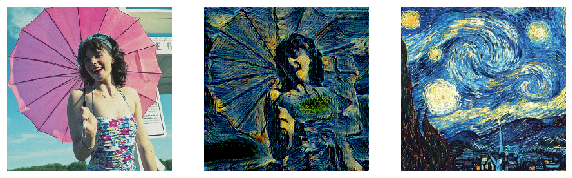

In [19]:
output = output.squeeze(0).detach().cpu().permute(1,2,0).numpy()

f, axarr = plt.subplots(1, 3, figsize=(10,10))
axarr[0].imshow(content_img.squeeze(0).cpu().permute(1,2,0).numpy())
axarr[0].axis('off')
axarr[1].imshow(output)
axarr[1].axis('off')
axarr[2].imshow(style_img.squeeze(0).cpu().permute(1,2,0).numpy())
axarr[2].axis('off')

In [20]:
k = 6
data = next(iter(loader(dataset, k)))

In [21]:
def results(data, k, label):
    if torch.cuda.is_available():
        data = data.cuda()
    style = style_dataset.__getitem__(label)
    plt.imshow(style[1].permute(1,2,0).cpu().numpy())
    plt.title('Style Image')
    plt.axis('off')
    for i in range(k):
        fig, axarr = plt.subplots(1, 2, figsize=(9,9))
        pred = transformer(data[i].unsqueeze(0), label)
        axarr[0].imshow(data[i].permute(1,2,0).detach().cpu().numpy())
        axarr[0].axis('off')
        axarr[1].imshow(pred.squeeze().permute(1,2,0).detach().cpu().numpy())
        axarr[1].axis('off')

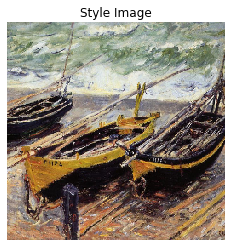

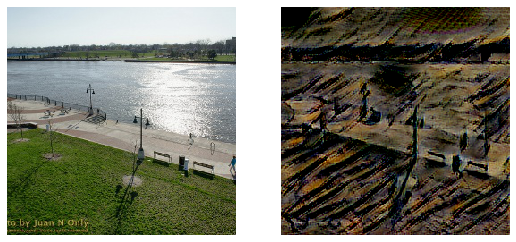

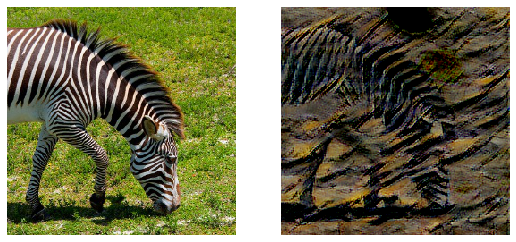

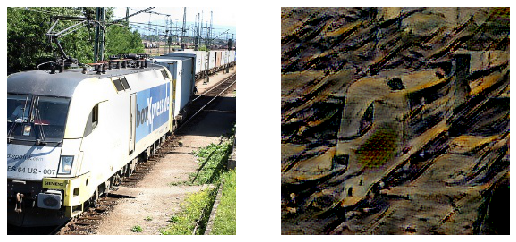

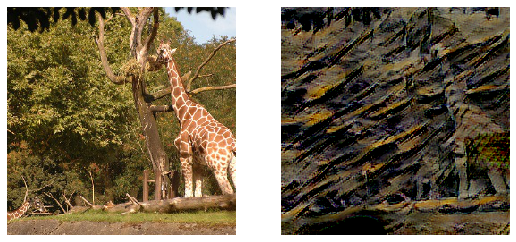

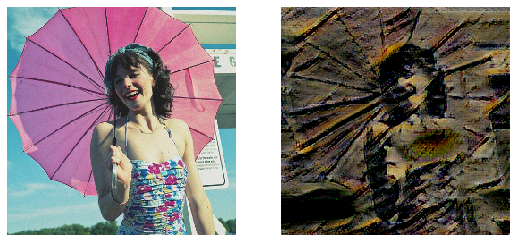

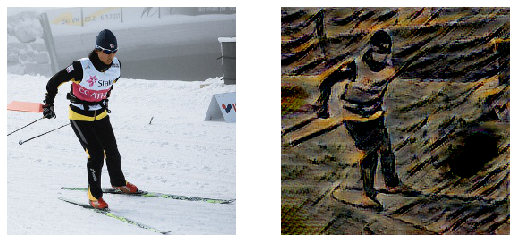

In [22]:
results(data, k, 0)

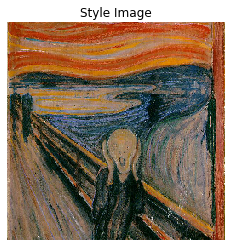

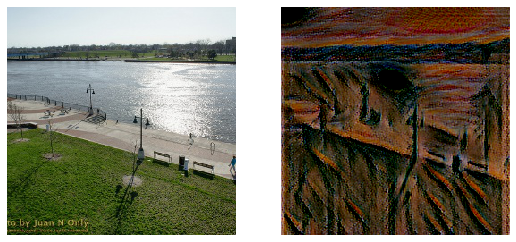

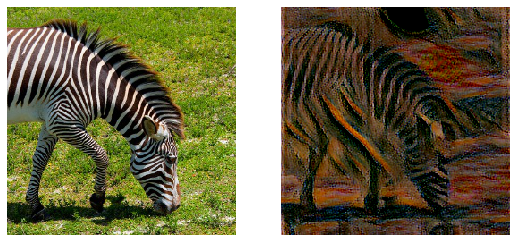

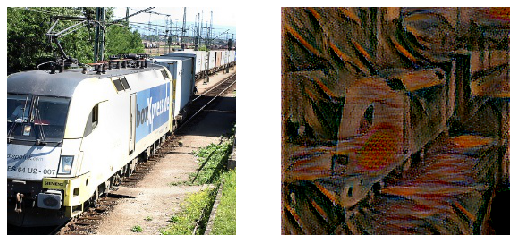

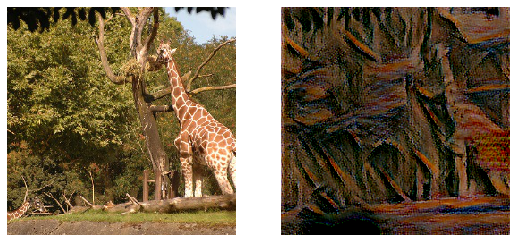

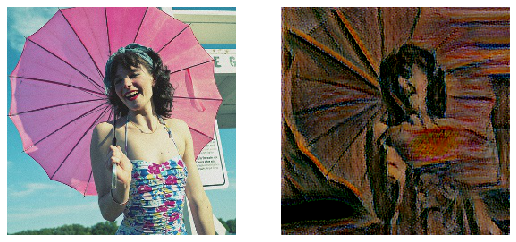

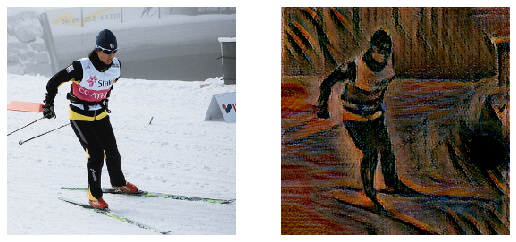

In [23]:
results(data, k, 1)

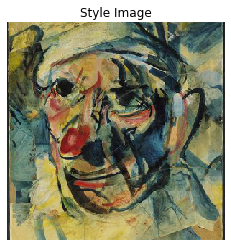

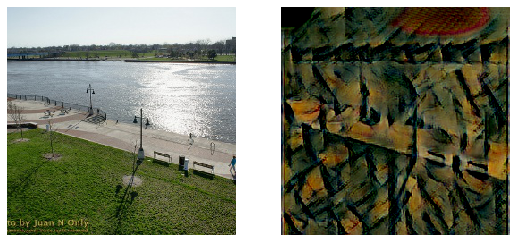

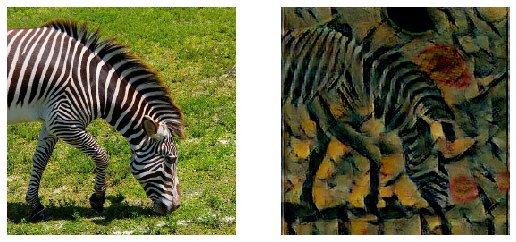

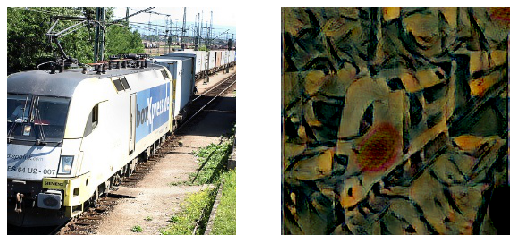

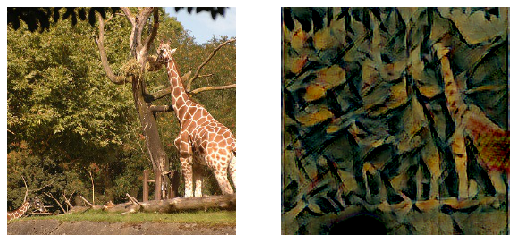

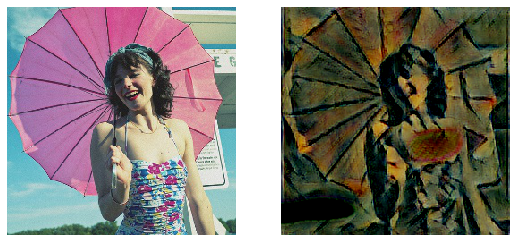

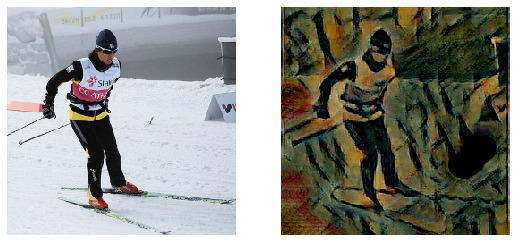

In [24]:
results(data, k, 2)

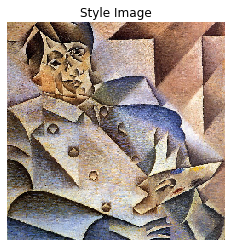

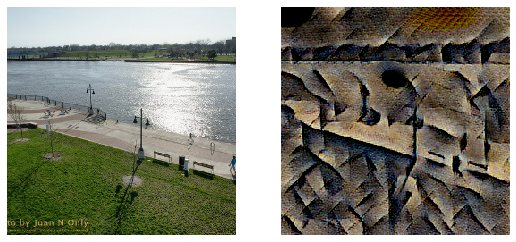

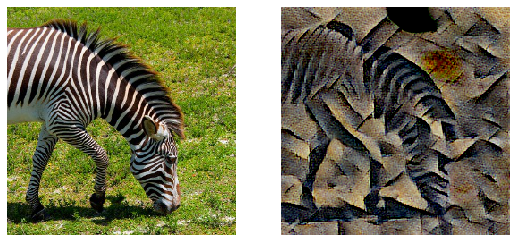

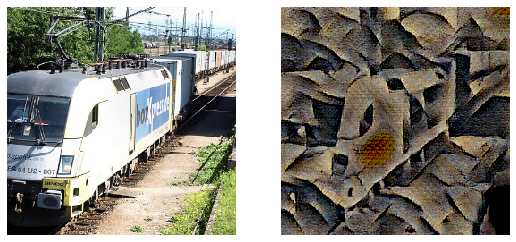

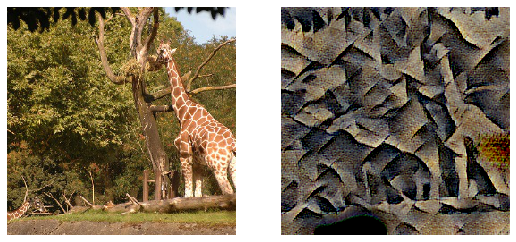

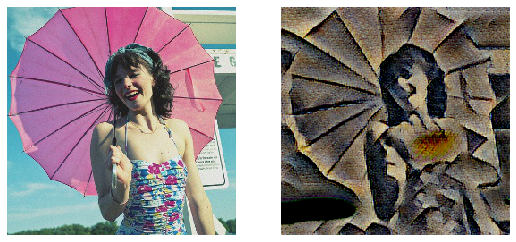

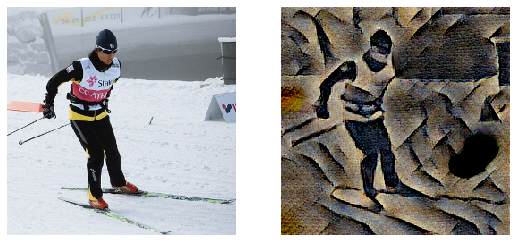

In [25]:
results(data, k, 3)

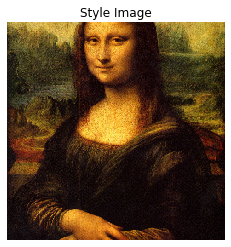

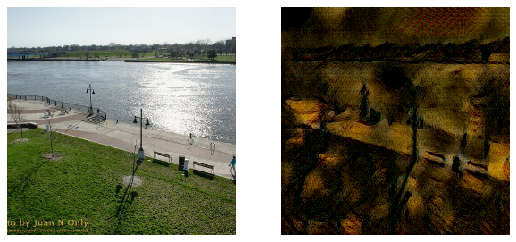

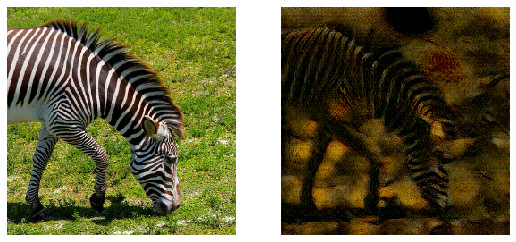

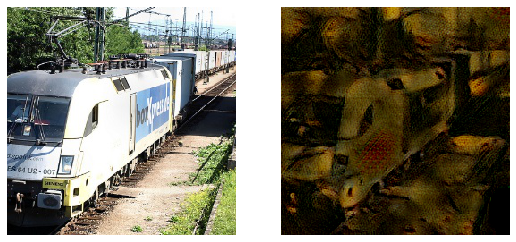

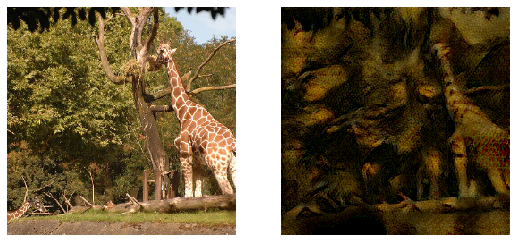

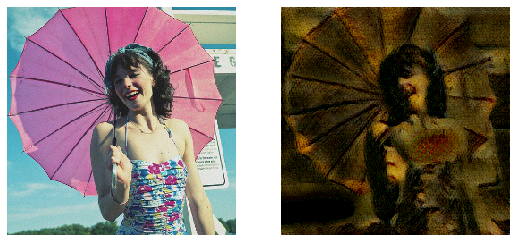

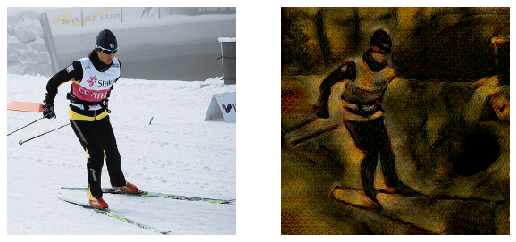

In [26]:
results(data, k, 4)

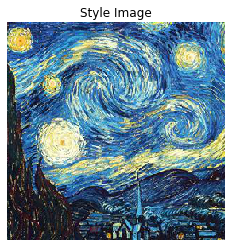

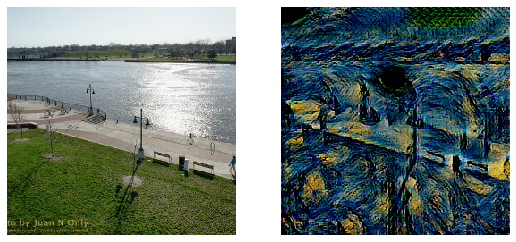

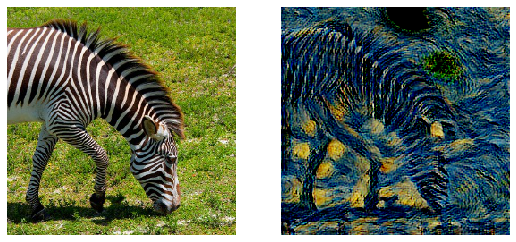

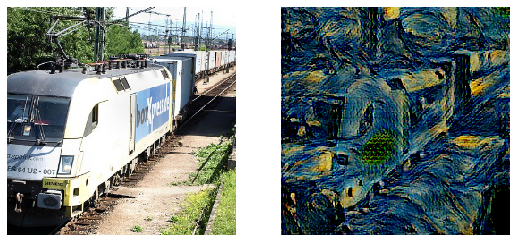

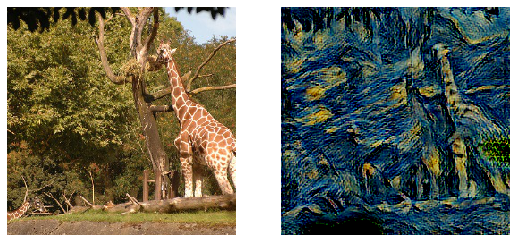

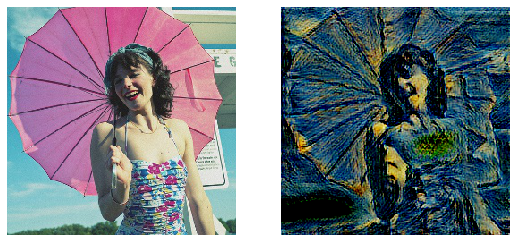

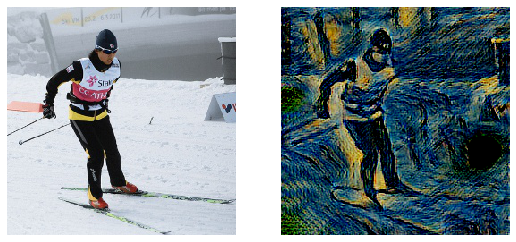

In [27]:
results(data, k, 5)

# **CelebA Dataset Style Transform**

In [29]:
# Your can download the entire dataset from  net or use sample celebrity images.
# celebDataset = CelebA('celebA',transform=Compose([ToTensor()]), download=True)
celebDataset = CocoDataset('celebA/')

In [32]:
batch = 4
dataC = next(iter(loader(celebDataset, batch)))

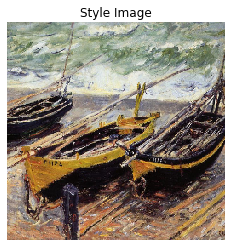

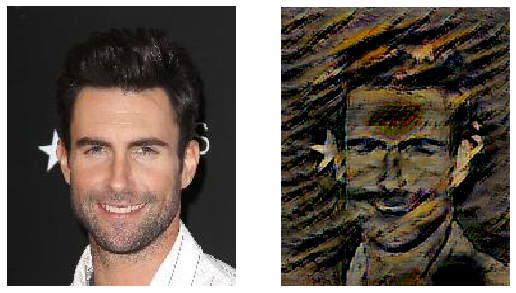

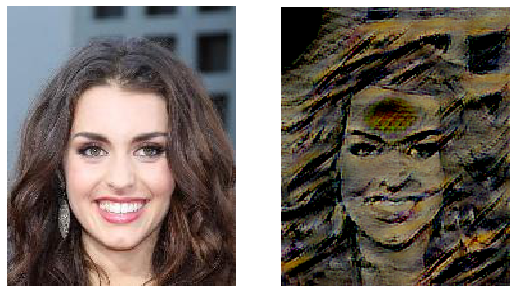

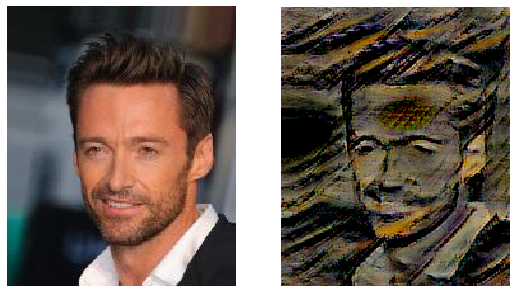

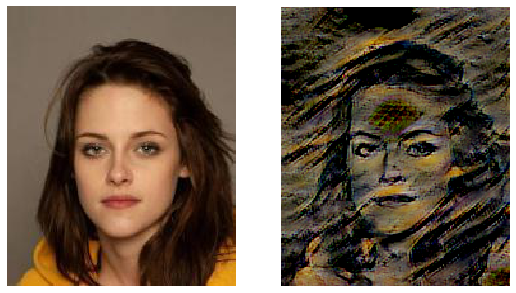

In [34]:
results(dataC, batch, 0)

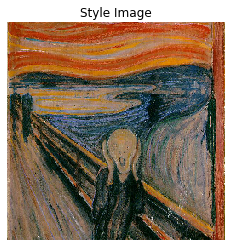

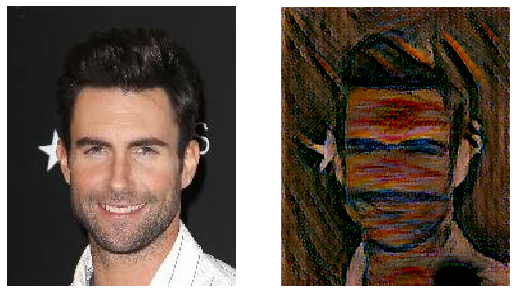

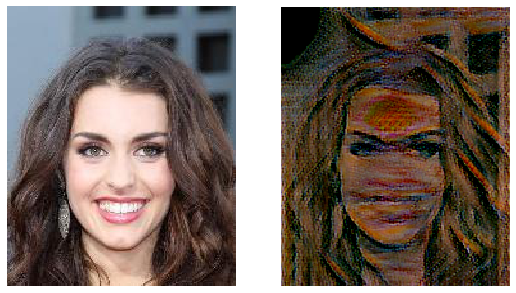

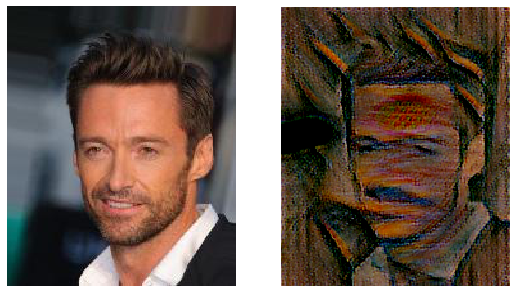

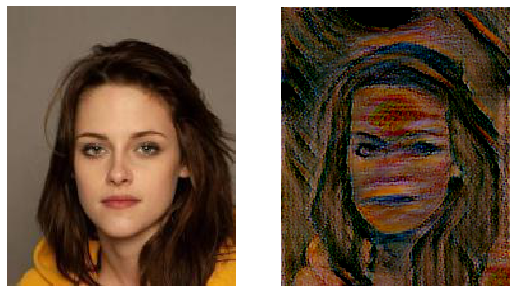

In [35]:
results(dataC, batch, 1)

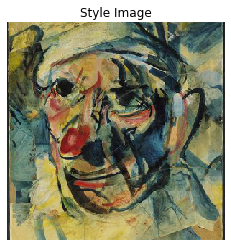

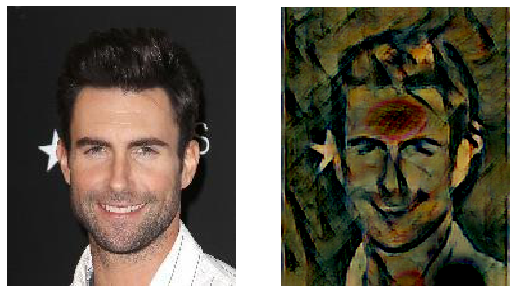

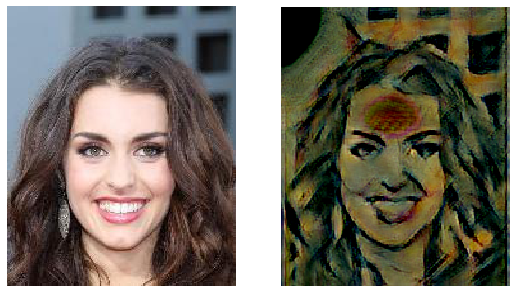

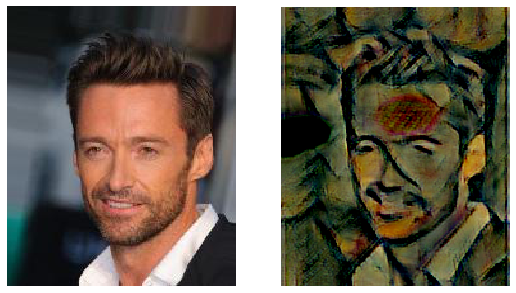

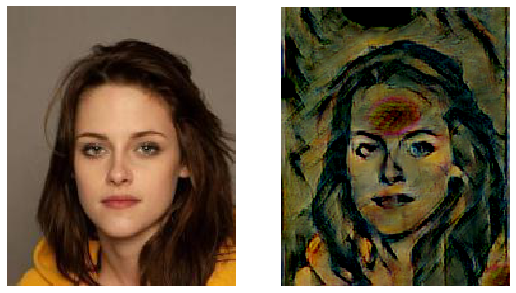

In [36]:
results(dataC, batch, 2)

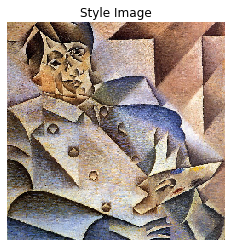

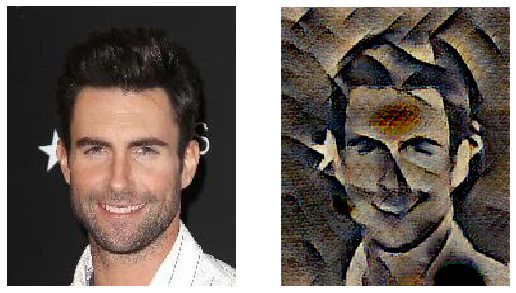

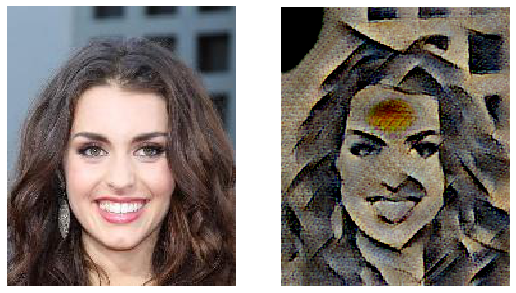

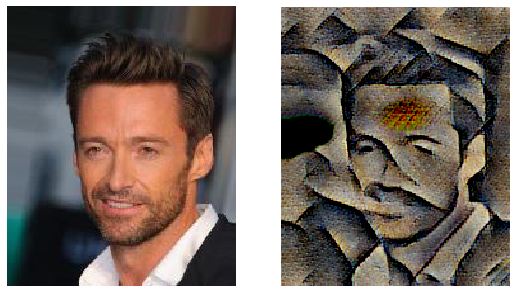

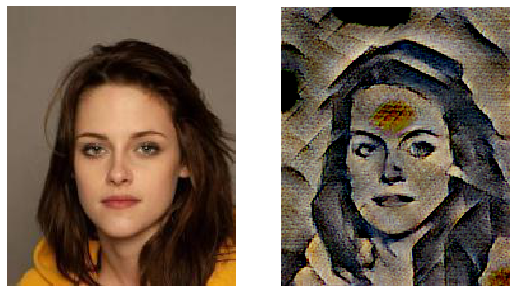

In [37]:
results(dataC, batch, 3)

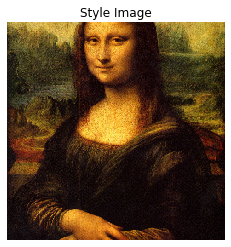

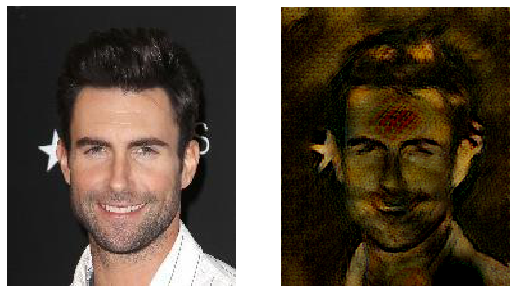

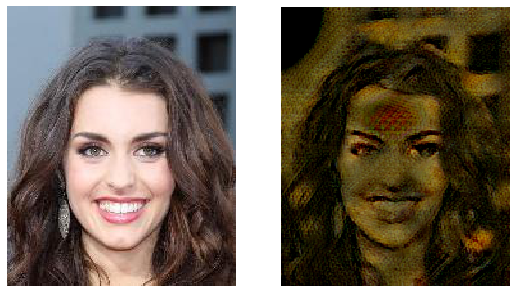

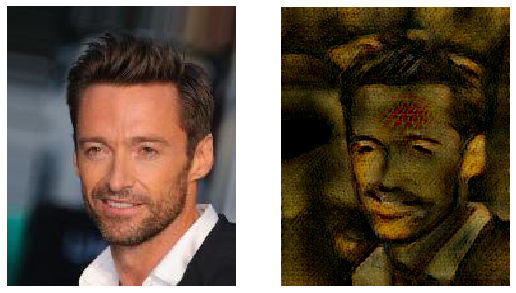

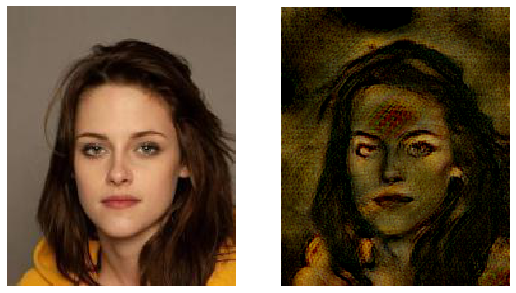

In [38]:
results(dataC, batch, 4)

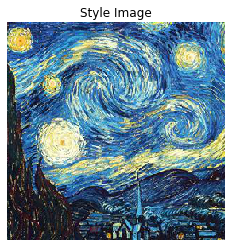

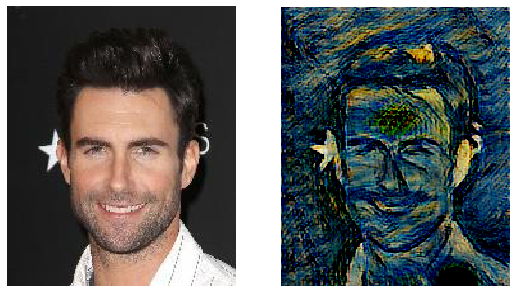

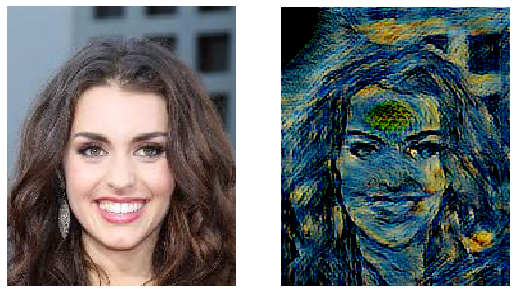

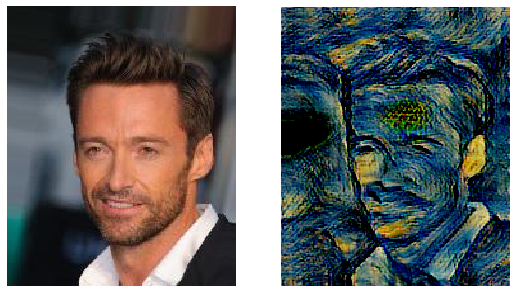

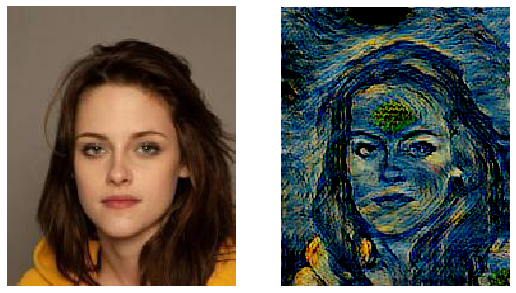

In [39]:
results(dataC, batch, 5)